In [1]:
import numpy as np
import cv2
# import time
# import os
# import PIL
# import matplotlib
from PIL import Image

### Helpers

In [2]:
def imshow(a):
    a = a.clip(0, 255).astype('uint8')
    if a.ndim == 3:
        if a.shape[2] == 4:
            a = cv2.cvtColor(a, cv2.COLOR_BGRA2RGBA)
        else:
            a = cv2.cvtColor(a, cv2.COLOR_BGR2RGB)
    display(Image.fromarray(a))

### Const

In [107]:
#Image size cons.
IM_WIDTH = 1920
IM_HEIGHT = 1080

# Adaptive threshold levels
BKG_THRESH = 60
CARD_THRESH = 30

# Width and height of card corner, where rank and suit are
CORNER_WIDTH = 32
CORNER_HEIGHT = 84

# Dimensions of rank train images
RANK_WIDTH = 70
RANK_HEIGHT = 125

# Dimensions of suit train images
SUIT_WIDTH = 70
SUIT_HEIGHT = 100

RANK_DIFF_MAX = 2000
SUIT_DIFF_MAX = 700

CARD_MAX_AREA = 150000
CARD_MIN_AREA = 50000

font = cv2.FONT_HERSHEY_SIMPLEX

### Classes and loaders

In [4]:
class Query_card:
    """Structure to store information about query cards in the camera image."""

    def __init__(self):
        self.contour = [] # Contour of card
        self.width, self.height = 0, 0 # Width and height of card
        self.corner_pts = [] # Corner points of card
        self.center = [] # Center point of card
        self.warp = [] # 200x300, flattened, grayed, blurred image
        self.rank_img = [] # Thresholded, sized image of card's rank
        self.suit_img = [] # Thresholded, sized image of card's suit
        self.best_rank_match = "Unknown" # Best matched rank
        self.best_suit_match = "Unknown" # Best matched suit
        self.rank_diff = 0 # Difference between rank image and best matched train rank image
        self.suit_diff = 0 # Difference between suit image and best matched train suit image
        self.half = None
        self.side = None
        self.size = 0

    def __call__(self):
      return self.best_rank_match + ' of ' + self.best_suit_match + ' with center in ' + str(self.center[0]) +', '+str(self.center[1]) + ' so on ' + self.half + ' half'


class Train_ranks:
    """Structure to store information about train rank images."""

    def __init__(self):
        self.img = [] # Thresholded, sized rank image loaded from hard drive
        self.name = "Placeholder"

class Train_suits:
    """Structure to store information about train suit images."""

    def __init__(self):
        self.img = [] # Thresholded, sized suit image loaded from hard drive
        self.name = "Placeholder"

In [83]:
def load_ranks(filepath):
    """Loads rank images from directory specified by filepath. Stores
    them in a list of Train_ranks objects."""

    train_ranks = []
    i = 0
    
    for Rank in ['Ace','Two','Three','Four','Five','Six','Seven',
                 'Eight','Nine','Ten','Jack','Queen','King', 'Queen2', 'Six2']:
        train_ranks.append(Train_ranks())
        if Rank != 'Queen2' and Rank != 'Six2':
            train_ranks[i].name = Rank
        else:
            train_ranks[i].name = Rank[:-1]
        filename = Rank + '.jpg'
        # print(filepath+filename)
        train_ranks[i].img = cv2.imread(filepath+filename, cv2.IMREAD_GRAYSCALE)
        i = i + 1

    return train_ranks


In [84]:
def load_suits(filepath):
    """Loads suit images from directory specified by filepath. Stores
    them in a list of Train_suits objects."""

    train_suits = []
    i = 0
    
    for Suit in ['Spades','Diamonds','Clubs','Hearts', 'Clubs2']:
        train_suits.append(Train_suits())
        if Suit != 'Clubs2':
            train_suits[i].name = Suit
        else:
            train_suits[i].name = 'Clubs'
        filename = Suit + '.jpg'
        train_suits[i].img = cv2.imread(filepath+filename, cv2.IMREAD_GRAYSCALE)
        i = i + 1

    return train_suits

### Functions

In [85]:
def preprocess_image(image):
    """Returns a grayed, blurred, and adaptively thresholded camera image."""

    gray = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    blur = cv2.GaussianBlur(gray,(9,9),0)
    
    thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 91, 8)

    return thresh

In [86]:
def find_cards(thresh_image):
    """Finds all card-sized contours in a thresholded camera image.
    Returns the number of cards, and a list of card contours sorted
    from largest to smallest."""

    # Find contours and sort their indices by contour size
    cnts, hier = cv2.findContours(thresh_image,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE)
    index_sort = sorted(range(len(cnts)), key=lambda i : cv2.contourArea(cnts[i]),reverse=True)

    # If there are no contours, do nothing
    if len(cnts) == 0:
        return [], []

    # Determine which of the contours are cards by applying the
    # following criteria: 1) Smaller area than the maximum card size,
    # 2), bigger area than the minimum card size, 3) have no parents,
    # and 4) have four corners
    finnal_cnts = []
    for i in range(len(cnts)):
        size = cv2.contourArea(cnts[i])
        peri = cv2.arcLength(cnts[i], True)
        approx = cv2.approxPolyDP(cnts[i], 0.01*peri, True)
        # print(size, len(approx), hier[0][i][3])
        if( (size < CARD_MAX_AREA) and (size > CARD_MIN_AREA) and (len(approx) == 4)):# and (hier[0][i][3] == -1 )):
            finnal_cnts.append(cnts[i])
    return finnal_cnts

In [87]:
def preprocess_card(contour, image, show = True):
  
    """Uses contour to find information about the query card. Isolates rank
        and suit images from the card."""

    # Initialize new Query_card object
    qCard = Query_card()
    qCard.contour = contour
    
    #save size for future
    size = cv2.contourArea(contour)
    qCard.size = size
    
    # Find perimeter of card and use it to approximate corner points
    peri = cv2.arcLength(contour,True)
    approx = cv2.approxPolyDP(contour,0.01*peri,True)
    pts = np.float32(approx)
    qCard.corner_pts = pts

    # Find width and height of card's bounding rectangle
    x,y,w,h = cv2.boundingRect(contour)
    ##########################################################        
    if show: image_copy = image.copy()
    if show: cv2.rectangle(image_copy, (x, y), (x+w, y+h), (0, 255, 0), 2)
    if show: imshow(image_copy)
    

    qCard.width, qCard.height = w, h

    # Find center point of card by taking x and y average of the four corners.
    average = np.sum(pts, axis=0)/len(pts)
    cent_x = int(average[0][0])
    cent_y = int(average[0][1])
    qCard.center = [cent_x, cent_y]

    if cent_y > IM_HEIGHT/2:
        qCard.half = 'bottom'
    else: qCard.half = 'top'

    if cent_x > IM_WIDTH/2:
        qCard.side = 'right'
    else:
        qCard.side = 'left'

    # Warp card into 200x300 flattened image using perspective transform
    # testa = (image.copy(), pts, w, h)
    qCard.warp = flattener(image, pts, w, h)
    if show: imshow(qCard.warp)

    # Grab corner of warped card image and do a 4x zoom
    Qcorner = qCard.warp[0:CORNER_HEIGHT, 0:CORNER_WIDTH]
    Qcorner_zoom = cv2.resize(Qcorner, (0,0), fx=4, fy=4)
    if show: imshow(Qcorner_zoom)
    # Sample known white pixel intensity to determine good threshold level

    # this adaptiveThreshold may need some tunning
    query_thresh = cv2.adaptiveThreshold(Qcorner_zoom, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY_INV, 91, 8)
    
    if show: imshow(query_thresh)
    
    # Split in to top and bottom half (top shows rank, bottom shows suit)
    Qrank = query_thresh[20:195, 0:128]
    Qsuit = query_thresh[195:336, 0:128]

    if show: print('##########################################################')
    if show: imshow(Qrank)
    if show: print('##########################################################')
    if show: imshow(Qsuit)

    qCard.rank_img = find_bounds(Qrank, RANK_WIDTH, RANK_HEIGHT)#Qrank_sized
    qCard.suit_img = find_bounds(Qsuit, SUIT_WIDTH, SUIT_HEIGHT)
   
    if show: print('##########################################################')
    if show: imshow(qCard.rank_img)
    if show: print('##########################################################')
    if show: imshow(qCard.suit_img)
    return qCard

In [88]:
def find_bounds(Q, WIDTH, HEIGHT):
    """Find countour and bounding rectangle, isolate and find largest contour and use 
        it to resize image to match dimensions"""
        
    cnts, hier = cv2.findContours(Q, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    cnts = sorted(cnts, key=cv2.contourArea, reverse=True)
    if len(cnts) != 0:
        x, y, w, h = cv2.boundingRect(cnts[0])
        roi = Q[y:y+h, x:x+w]
        sized = cv2.resize(roi, (WIDTH, HEIGHT), 0, 0)
        return sized
    return []

### Matching

In [89]:
def match_card(qCard, train_ranks, train_suits):
    """Finds best rank and suit matches for the query card. Differences
    the query card rank and suit images with the train rank and suit images.
    The best match is the rank or suit image that has the least difference."""

    best_rank_match_diff = 10000
    best_suit_match_diff = 10000
    best_rank_match_name = "Unknown"
    best_suit_match_name = "Unknown"
    i = 0

    # If no contours were found in query card in preprocess_card function,
    # the img size is zero, so skip the differencing process
    # (card will be left as Unknown)


    if (len(qCard.rank_img) != 0) and (len(qCard.suit_img) != 0):

        best_rank_name, best_rank_match_diff = find_most_simmilar(qCard.rank_img, train_ranks)
        best_suit_name, best_suit_match_diff = find_most_simmilar(qCard.suit_img, train_suits)
        

    # Combine best rank match and best suit match to get query card's identity.
    # If the best matches have too high of a difference value, card identity
    # is still Unknown
    if (best_rank_match_diff < RANK_DIFF_MAX):
        best_rank_match_name = best_rank_name

    if (best_suit_match_diff < SUIT_DIFF_MAX):
        best_suit_match_name = best_suit_name

    # Return the identiy of the card and the quality of the suit and rank match
    return best_rank_match_name, best_suit_match_name, best_rank_match_diff, best_suit_match_diff

In [90]:
def find_most_simmilar(image, train_set):
    """ Difference the query card image from each of the train images,
        and return the result with the least difference """
    best_match_diff = 10000
    best_name = "Unknown"

    for element in train_set:

        diff_img = cv2.absdiff(image, element.img)
        diff = int(np.sum(diff_img)/255)
        
        if diff < best_match_diff:
            # best_diff_img = diff_img
            best_match_diff = diff
            best_name = element.name
    return best_name, best_match_diff

In [91]:
def find_corners(pts, w, h):
    ''' From un ordered cornner points, return order cornner points ''' 

    temp_rect = np.zeros((4,2), dtype = "float32")

    s = np.sum(pts, axis = 2)
    # top left corner have smaller sum
    top_left = pts[np.argmin(s)]
    # bottom_left corner have smaller sum
    bottom_right = pts[np.argmax(s)]

    diff = np.diff(pts, axis = -1)
    # top right cornner have smaller diffrence
    top_right = pts[np.argmin(diff)]
    # bottom left cornner have smaller diffrence
    bottom_left = pts[np.argmax(diff)]

    if w <= 0.8*h: # If card is vertically oriented
        temp_rect[0] = top_left
        temp_rect[1] = top_right
        temp_rect[2] = bottom_right
        temp_rect[3] = bottom_left

    elif w >= 1.2*h: # If card is horizontally oriented
        temp_rect[0] = bottom_left
        temp_rect[1] = top_left
        temp_rect[2] = top_right
        temp_rect[3] = bottom_right
    
    else: #If card is diamond oriented
        # If furthest left point is higher than furthest right point,
        # card is tilted to the left.
        if pts[1][0][1] <= pts[3][0][1]:
            # If card is titled to the left, approxPolyDP returns points
            # in this order: top right, top left, bottom left, bottom right
            temp_rect[0] = pts[1][0] # Top left
            temp_rect[1] = pts[0][0] # Top right
            temp_rect[2] = pts[3][0] # Bottom right
            temp_rect[3] = pts[2][0] # Bottom left

        # If furthest left point is lower than furthest right point,
        # card is tilted to the right
        else:
            # If card is titled to the right, approxPolyDP returns points
            # in this order: top left, bottom left, bottom right, top right
            temp_rect[0] = pts[0][0] # Top left
            temp_rect[1] = pts[3][0] # Top right
            temp_rect[2] = pts[2][0] # Bottom right
            temp_rect[3] = pts[1][0] # Bottom left

    return temp_rect

In [92]:
def find_coins(image):
    coins = [[],[]]
    circles = cv2.HoughCircles(image, cv2.HOUGH_GRADIENT, 1, 80, param1=32,  param2=32, minRadius=50, maxRadius=70)
# ensure at least som e circles were found
    if circles is not None:
        # convert the (x, y) coordinates and radius of the circles to integers
        circles = np.round(circles[0, :]).astype("int")
        # loop over the (x, y) coordinates and radius of the circles
        for (x, y, r) in circles:
            if y < 150:
                if x > IM_WIDTH/2:
                    # side = 
                    coins[1].append(Coin((x,y,r), 'right'))
                else:
                    coins[0].append(Coin((x,y,r), 'left'))

    return coins


In [93]:
def flattener(image, pts, w, h):
    # print(pts)
    """Flattens an image of a card into a top-down 200x300 perspective.
    Returns the flattened, re-sized, grayed image.
    See www.pyimagesearch.com/2014/08/25/4-point-opencv-getperspective-transform-example/"""

    corrner_points = find_corners(pts, w, h)        
        
    maxWidth = 200
    maxHeight = 300

    # Create destination array, calculate perspective transform matrix,
    # and warp card image
    dst = np.array([[0,0],[maxWidth-1,0],[maxWidth-1,maxHeight-1],[0, maxHeight-1]], np.float32)
    M = cv2.getPerspectiveTransform(corrner_points, dst)
    warp = cv2.warpPerspective(image, M, (maxWidth, maxHeight))
    warp = cv2.cvtColor(warp,cv2.COLOR_BGR2GRAY)

    return warp

### Main (New)

In [94]:
def count_points(cards, half, side):
    total = 0
    for card in cards:
        if card.half == half and card.side in side:
            if card.best_rank_match ==  'Two':
                total += 2
            elif card.best_rank_match ==  'Three':
                total += 3
            elif card.best_rank_match ==  'Four':
                total += 4
            elif card.best_rank_match ==  'Five':
                total += 5
            elif card.best_rank_match ==  'Six':
                total += 6
            elif card.best_rank_match ==  'Seven':
                total += 7
            elif card.best_rank_match ==  'Eight':
                total += 8
            elif card.best_rank_match ==  'Nine':
                total += 9
            elif (card.best_rank_match ==  'Jack' or card.best_rank_match ==  'Queen'
            or card.best_rank_match ==  'King'  or card.best_rank_match ==  'Ten'):
                total += 10
            elif card.best_rank_match ==  'Ace':
                if total+10>21: 
                    total+=1
                else: 
                    total+=10
    return total

In [95]:
import math
def shortes_distance(card, cards):
    min_d = 10000
    closted = None
    for cardx in cards:
        dist = math.sqrt((cardx.center[0]-card.center[0])**2 + (cardx.center[1]-card.center[1])**2 )
        if dist < min_d: 
            min_d = dist
            closted = cardx
    return min_d, closted

def shortes_distance_coins(coin, coins):
    min_d =  10000
    closted = None
    for coinx in coins:
        dist = math.sqrt((coinx.pos[0] - coin.pos[0])**2 + (coinx.pos[1]-coin.pos[1])**2)
        if dist < min_d:
            min_d = dist
            closted = coinx
    return min_d, closted

# Drawing

In [96]:
def draw_results(image, qCard):
    """Draw the card name, center point, and contour on the camera image."""

    x = qCard.center[0]
    y = qCard.center[1]
    rank_name = qCard.best_rank_match
    suit_name = qCard.best_suit_match

    if rank_name != "Unknown" or suit_name != "Unknown":

        if suit_name != 'rewers' and suit_name != 'deck':
            cv2.circle(image,(x,y),5,(255,0,0),-1)

            # Draw card name twice, so letters have black outline
            cv2.putText(image,(rank_name+' of'),(x-60,y-10),font,1,(0, 0, 0),4,cv2.LINE_AA)
            cv2.putText(image,(rank_name+' of'),(x-60,y-10),font,1,(0, 246, 147),2,cv2.LINE_AA)

            cv2.putText(image,suit_name,(x-60,y+25),font,1,(0, 0, 0),4,cv2.LINE_AA)
            cv2.putText(image,suit_name,(x-60,y+25),font,1,(0, 246, 147),2,cv2.LINE_AA)
        else:
            # print('here')
            cv2.putText(image,suit_name,(x-60,y),font,1,(0, 0, 0),4,cv2.LINE_AA)
            cv2.putText(image,suit_name,(x-60,y),font,1,(0, 246, 147),2,cv2.LINE_AA)
        
    return image

In [97]:
def draw_points(image, game):
    pos = [(IM_WIDTH//2, IM_HEIGHT//2 + 20), (30, 60), (IM_WIDTH//2, 60)]
    for player, (x, y) in zip(game.players, pos):
        cv2.putText( image, (player.name+' points ' + str(player.points)), (x, y), font,1,(147,246,200),3,cv2.LINE_AA)
        cv2.putText( image, (player.name+' cards ' + str(player.total_cards)), (x, y+50), font,1,(147,246,200),3,cv2.LINE_AA)


    cv2.putText( image, ('Player1 coins ' + str(game.players[1].coins)),(30, 160),font,1,(147,246,200),3,cv2.LINE_AA)
    cv2.putText( image, ('Player2 coins ' + str(game.players[2].coins)),(IM_WIDTH//2, 160),font,1,(147,246,200),3,cv2.LINE_AA)

    return image

In [98]:
def draw_actions(image, game):
    if len(game.actions_to_print) > 0:
        height = IM_HEIGHT//2 + 100
        for action in game.actions_to_print:
            cv2.putText( image, (action), (50, height), font, 1, (0, 0, 0), 3, cv2.LINE_AA)
            height += 50
    return image

In [99]:
def draw_coins(image, game):
    if len(game.coins) > 0:
        for player in game.coins:
            for coin in player:
                x, y, r = coin.pos
                cv2.circle(image, (x, y), r, (0, 255, 0), 4)
    return image

### Video

# Player and Coin classes


In [100]:
class Player:
    def __init__(self, name):
        self.name = name
        self.prev_points = 0
        self.points = 0
        self.busted = False
        self.coins = 0
        self.total_cards = 0
        self.prev_total_cards = 0
        self.raised = False


In [101]:
class Coin:
    def __init__(self, pos, side):
        self.pos = pos
        self.side = side

In [108]:
class Game:
    def __init__(self, players):
        self.players = players #[dealer, player1, player2]
        self.cards = []
        self.coins = [[],[]]
        self.prev_cards = []
        self.prev_coins = [[],[]]
        self.was_all_zeros = []
        self.actions = [[] for i in range(10)] # x= 5 is for how long (x*15 frames)
        self.actions_to_print = []
        self.deck = None
        self.rewers = None

        #Now some fun with flags
        self.was_rewers_puted = False
        self.was_rewers_inverted = False
        self.temp = False #something for rewerse
        self.game_ended = False
        self.end_of_dealing = False

    def set_points(self):
        ''' Set new number of points in game for each player, only if this number is greater than prev score'''
        dealer_p = count_points(self.cards, 'bottom', ['left', 'right'])
        p1_p = count_points(self.cards, 'top', ['left'])
        p2_p = count_points(self.cards, 'top', ['right'])

        if dealer_p == 0 and p1_p == 0 and p2_p == 0:
            self.was_all_zeros.append(True)
        else: self.was_all_zeros.append(False)
        
        self.players[0].points = dealer_p
        self.players[1].points = p1_p
        self.players[2].points = p2_p

    def set_coins(self):
        player1_coins = len(self.coins[0])
        player2_coins = len(self.coins[1])
        if self.players[1].coins < player1_coins:
            self.players[1].coins = player1_coins
        if self.players[2].coins < player2_coins:
            self.players[2].coins = player2_coins

    def clean_cards(self):
        ''' Remove all cards thats have unknown rank and suit and add deck and rewers'''
        too_remove = []
        for card in self.cards:
            if card.best_rank_match == "Unknown" and (card.best_suit_match == "Unknown" or card.best_suit_match == 'rewers'):
                too_remove.append(card)
        self.cards = [card for card in self.cards if card not in too_remove]
    
    def add_deck(self):
        if self.deck != None:
            self.cards.append(self.deck)
        if self.rewers != None:
            dist, clost_card = shortes_distance(self.rewers, self.cards)
            if dist > 20:
                
                self.cards.append(self.rewers)
            else:
                self.rewers = None


    def restore_cards(self):
        '''if some card was found prevoisly, but is not found currently, restore it'''
        curr_set = []

        if len(self.cards) > 0: # do it only when find any card
            for card in self.cards:
                curr_set.append((card.best_rank_match, card.best_suit_match))
            if len(self.cards) > 1: 
                for card in self.prev_cards:
                    if (card.best_rank_match, card.best_suit_match) not in curr_set:
                        if card.best_suit_match != 'rewers':
                            dist, clost_card = shortes_distance(card, self.cards)
                            if  dist > 10:
                                self.cards.append(card)
                            else:
                                if dist < 2:
                                    # in worst case scen. 'Unknown' will change into 'Unknown'
                                    if clost_card.best_rank_match == 'Unknown' and clost_card.best_suit_match != 'deck':
                                        clost_card.best_rank_match = card.best_rank_match

                                    if clost_card.best_suit_match == 'Unknown':
                                        clost_card.best_suit_match = card.best_suit_match
        
    def restore_coins(self):
        '''restore coins that are not found, but was found early'''
        for i in range(2):
            for coin in self.prev_coins[i]:
                dist, clost_coin = shortes_distance_coins(coin, self.coins[i])
                # prin
                if dist > 50: 
                    self.coins[i].append(coin)

                    
        
        
    def set_prev(self):
        '''at the end, set current state of the game as previous'''

        for player in self.players:
            player.prev_points = player.points
            player.prev_total_cards = player.total_cards
        self.prev_cards = self.cards
        self.prev_coins = self.coins

    def search_action(self):

        for player in self.players: ### points -> total_cards
            if player.prev_total_cards != player.total_cards and player.total_cards != 0 and (self.was_rewers_inverted == False or self.temp == True):
                
                self.actions = [x+['dealer deals ' + str(player.name)] for x in self.actions[:5]]

            if self.was_rewers_inverted == True:
                self.temp = True

            if player.points > 21 and player.busted == False:
                player.busted = True
                self.actions = [x+[str(player.name) + ' busted'] for x in self.actions[:5]]
        
        if self.players[0].points > 17:
            self.game_ended = True

        if self.players[1].coins > 1 and self.players[1].raised == False and self.was_rewers_inverted == False and self.was_rewers_puted == True:
            self.players[1].raised = True
            self.actions = [x + [str(self.players[1].name) + ' double his bet'] for x in self.actions[:5]]

        # if self.dealer_points > 21:
        #     self.actions = [x+['dealer busted'] for x in self.actions]
            #both plaeyr wins

        self.actions_to_print = self.actions.pop(0)
        self.actions.append([])


    def search_deck(self):
        deck = []
        rewers = []
        for card in self.cards:
            if card.side == 'left' and card.half == 'bottom': 
                if card.center[0] < IM_WIDTH/4:
                    deck.append(card)
                else: rewers.append(card)
        if len(deck) > 0:
            max_size = 0
            display_deck = None
            for card in deck:
                if card.size > max_size:
                    max_size = card.size
                    display_deck = card
                    display_deck.best_suit_match = 'deck'
            self.deck = display_deck
        else:
            self.deck = None

        if len(rewers) > 0:
            max_size = 0
            display_rewers = None
            for card in rewers:
                if card.best_suit_match != 'Unknown' or card.best_rank_match != 'Unknown':
                    self.rewers = None
                    break
                if card.size > max_size:
                    max_size = card.size
                    display_rewers = card
                    display_rewers.best_suit_match = 'rewers'
            # rewers = random.choice(rewers)
            # if rewers.best_suit_match == 'Unknown':
            if display_rewers != None and self.was_rewers_puted == False: 
                self.was_rewers_puted = True
            if display_rewers == None and self.was_rewers_puted == True and self.was_rewers_inverted == False: 
                self.was_rewers_inverted = True
                self.actions = [x+['secret card inverted'] for x in self.actions]
            self.rewers = display_rewers
        else:
            self.rewers = None

    def count_cards(self):
        dealer = []
        player1 = []
        player2 = []
        for card in self.cards:
            if card.side == 'left' and card.half == 'top':
                player1.append(card)
            if card.side == 'right' and card.half == 'top':
                player2.append(card)
            else:
                if card.side == 'right' and card.half == 'bottom':
                    dealer.append(card)


        self.players[0].total_cards = len(dealer) + self.was_rewers_puted
        self.players[1].total_cards = len(player1)
        self.players[2].total_cards = len(player2)

        if self.players[0].total_cards == 2:
            self.end_of_dealing = True

    def new_game(self):
        aa = sum([1 for x in self.was_all_zeros[-5:] if x is True])
        if aa == 5: #if during 3 checks(75 frames) noone have any points, its mean it is new game
            return True
        return False

    def who_win(self):
        dealer, player1, player2 = self.players
        winners = []
        if dealer.busted: 
            if player1.busted == False:
                winners.append(player1)
            if player2.busted == False:
                winners.append(player2)
        if dealer.busted == False:
            if dealer.points > player1.points or dealer.points > player2.points or (player1.points):
                winners.append(True)
        return 'aaa'



# Logic controller

In [109]:
def f(frame, search, new_game, debug = False):

    global game
    if new_game: # at the begging, or when is nessesery, create  new game
        players = [Player('dealer'), Player('player1'), Player('player2')]
        game = Game(players)
        new_game = False

    if search: #only every 15 frame do this part 
        cards = []
        pre_proc = preprocess_image(frame)
        card_cnts = find_cards(pre_proc)

        if len(card_cnts) != 0:

            for i in range(len(card_cnts)):
                cards.append(preprocess_card(card_cnts[i], frame, debug))
                            
                cards[i].best_rank_match, cards[i].best_suit_match, cards[i].rank_diff, cards[i].suit_diff = match_card(cards[i], train_ranks, train_suits)
                
        game.coins = find_coins(pre_proc)
        game.cards = cards
        
        game.search_deck() #find deck and rewers
        game.clean_cards() # deleate all non card from cards
        game.restore_cards() #restore cards from prev iter
        game.restore_coins() #restore coins from prev iter
        game.add_deck() #add deck and rewers
        
        
        game.search_action() #search for basic actions
        game.count_cards()
        game.set_prev() # set current state of the game as previosuly for next iter
        
        game.set_coins() #cet number of coins and points for print
        game.set_points()
                

    if (len(game.cards) != 0):
        for card in game.cards:
            frame = draw_results(frame, card)

        temp_cnts = []
        for i in range(len(game.cards)):
            temp_cnts.append(game.cards[i].contour)
        cv2.drawContours(frame,temp_cnts, -1, (255,0,0), 2)
        
        frame = draw_coins(frame, game)
        frame = draw_actions(frame, game)
        frame = draw_points(frame, game)

    if search:
        new_game = game.new_game()
        if new_game == True:
            winners = game.who_win()
            print(winners)
    
    return frame, game.cards, new_game

In [110]:
train_ranks = load_ranks('Card_Imgs/')
train_suits = load_suits('Card_Imgs/')

In [112]:
cap = cv2.VideoCapture('Test_Video/video3.mp4')

fourcc = cv2.VideoWriter_fourcc(*'MP4V')
out = cv2.VideoWriter('Output_Video/output3.mp4', fourcc, 30.0, (1920, 1080))
frames_count = 0
last_frame = None
new_game = True
game = None
# players = [Player('dealer'), Player('player1'), Player('player2')]
# game = Game(players)
while cap.isOpened():
    ret, frame = cap.read()
    frames_count += 1
    # if frame is read correctly ret is True
    if not ret:
        print("Can't receive frame (stream end?). Exiting ...")
        break
    # if frames_count == 1300: # TODO: chcek coins
    #     last_frame = frame
    #     break
    
    if frames_count % 15 == 0: # search for cards only on every 15's frame
        frame, cards, new_game = f(frame, True, new_game)
    else:
        frame, cards, new_game = f(frame, False, new_game)

    out.write(frame)

    if cv2.waitKey(1) == ord('q'):
        break

cap.release()
out.release()


aaa
aaa
aaa
aaa
aaa
aaa
Can't receive frame (stream end?). Exiting ...


In [106]:
print(len(cards))
for card in cards:
    print(card.best_rank_match,  card.best_suit_match, card.size)

8
Six Diamonds 71800.0
Queen Spades 71888.5
Four Clubs 72264.0
Unknown deck 66170.5
King Diamonds 75244.0
King Hearts 74075.0
Queen Diamonds 69421.5
Unknown deck 66170.5


In [36]:
def f2(frame, search, game, debug = False):
    if search: #only every 15 frame do this part
        cards = []
        pre_proc = preprocess_image(frame)
        # imshow(pre_proc)
        card_cnts = find_cards(pre_proc)

        if len(card_cnts) != 0:

            for i in range(len(card_cnts)):
                cards.append(preprocess_card(card_cnts[i], frame, debug))
                            
                cards[i].best_rank_match, cards[i].best_suit_match, cards[i].rank_diff, cards[i].suit_diff = match_card(cards[i], train_ranks, train_suits)
                
        game.coins = find_coins(pre_proc)

        game.cards = cards
        # game.search_deck() #find deck and rewers
        # game.clean_cards() # deleate all non card from cards
        # game.restore() #restore cards from prev iter
        # game.add_deck() #add deck and rewers
        
        
        # game.search_action()
        # if len(game.actions_to_print) > 0: print(game.actions_to_print) 
        # game.count_cards()
        # game.set_prev()
        
        # game.set_coins()
        # game.set_points()
                

    if (len(game.cards) != 0):
        for card in game.cards:
            frame = draw_results(frame, card)

        temp_cnts = []
        for i in range(len(game.cards)):
            temp_cnts.append(game.cards[i].contour)
        cv2.drawContours(frame,temp_cnts, -1, (255,0,0), 2)
        
        # frame = draw_coins(frame, game)
        # frame = draw_actions(frame, game)
        # frame = draw_points(frame, game)
    
    return frame, game.cards

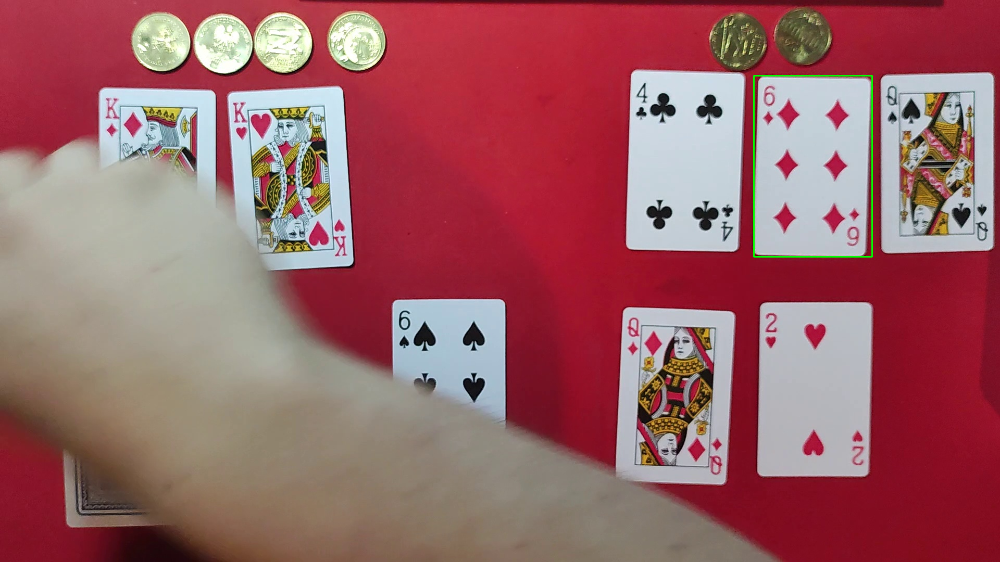

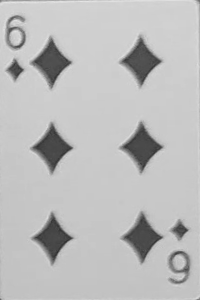

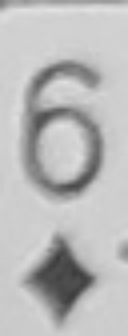

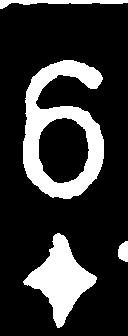

##########################################################


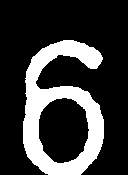

##########################################################


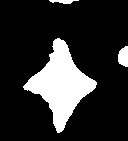

##########################################################


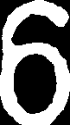

##########################################################


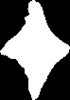

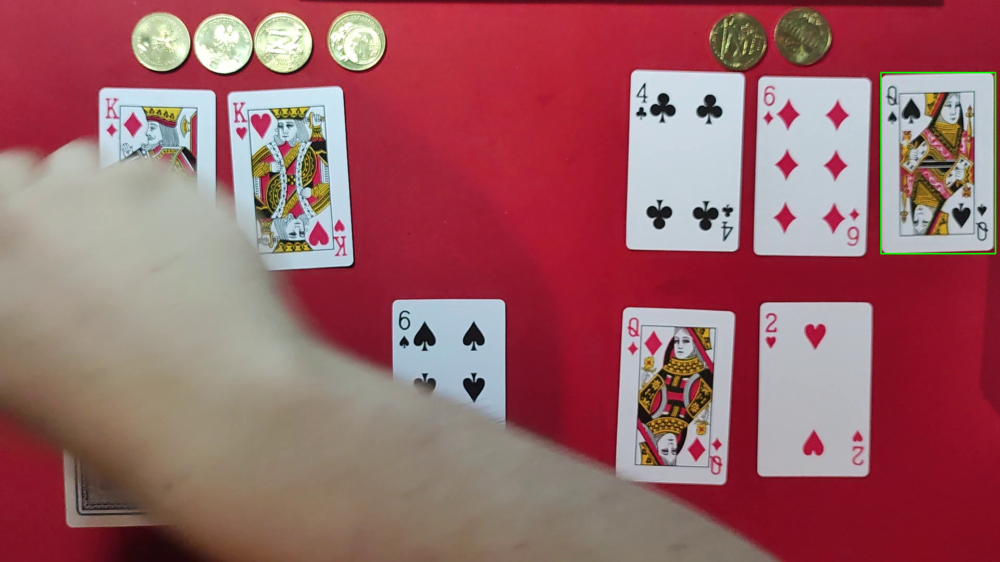

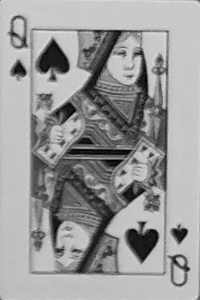

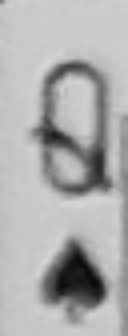

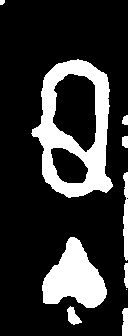

##########################################################


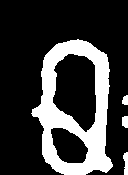

##########################################################


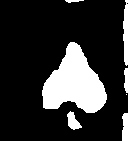

##########################################################


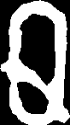

##########################################################


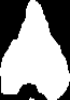

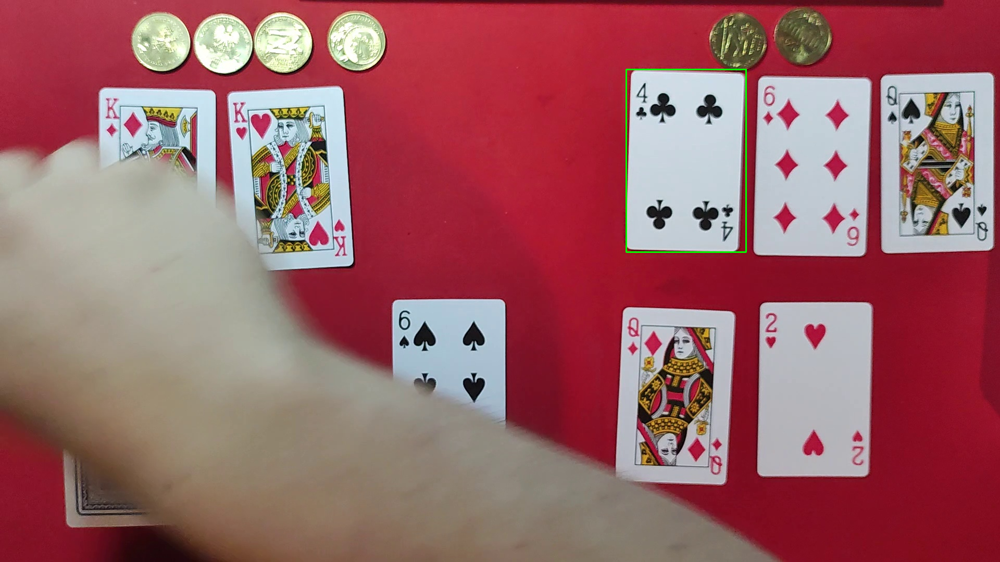

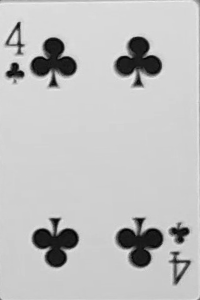

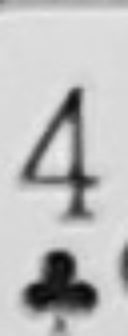

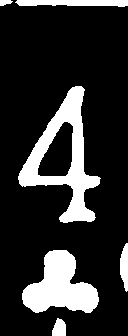

##########################################################


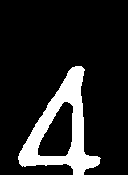

##########################################################


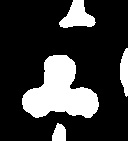

##########################################################


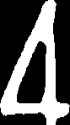

##########################################################


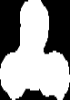

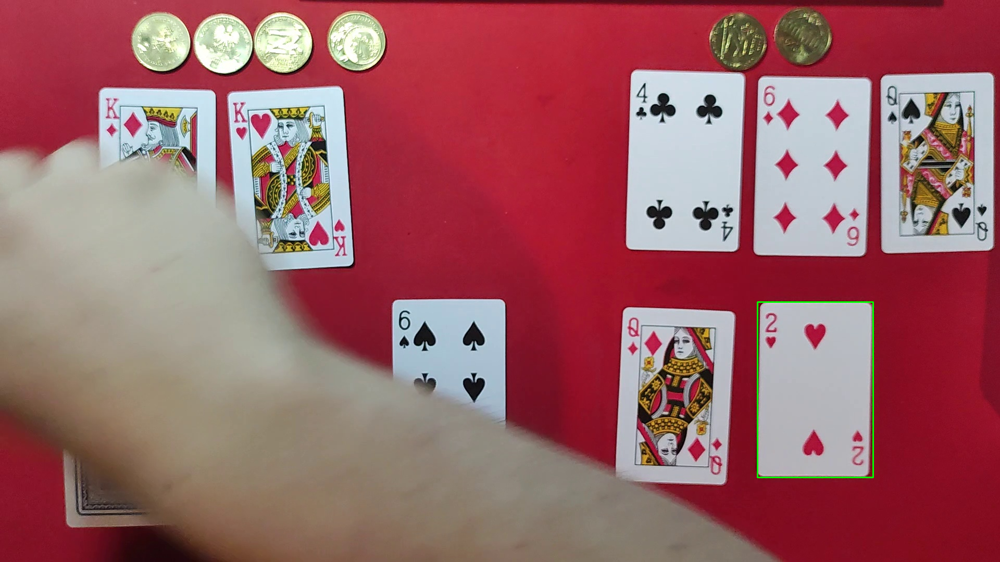

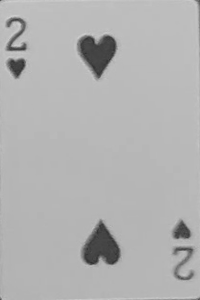

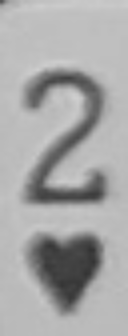

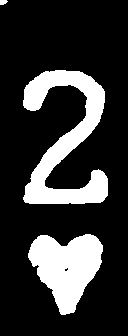

##########################################################


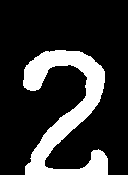

##########################################################


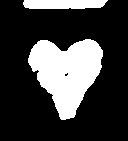

##########################################################


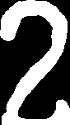

##########################################################


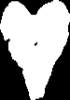

In [39]:
image = cv2.imread('test_Imgs/debug.jpg')
players = [Player('dealer'), Player('player1'), Player('player2')]

a, b = f2(image, True, Game(players), True)

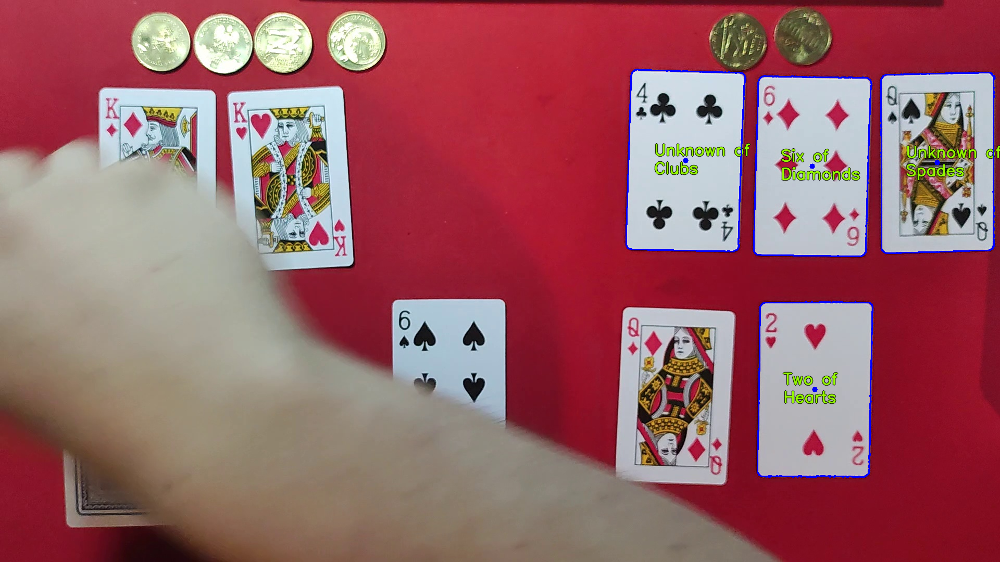

In [40]:
imshow(a)

In [464]:
cv2.imwrite('test_Imgs/debug.jpg', last_frame)

True

1.1 60


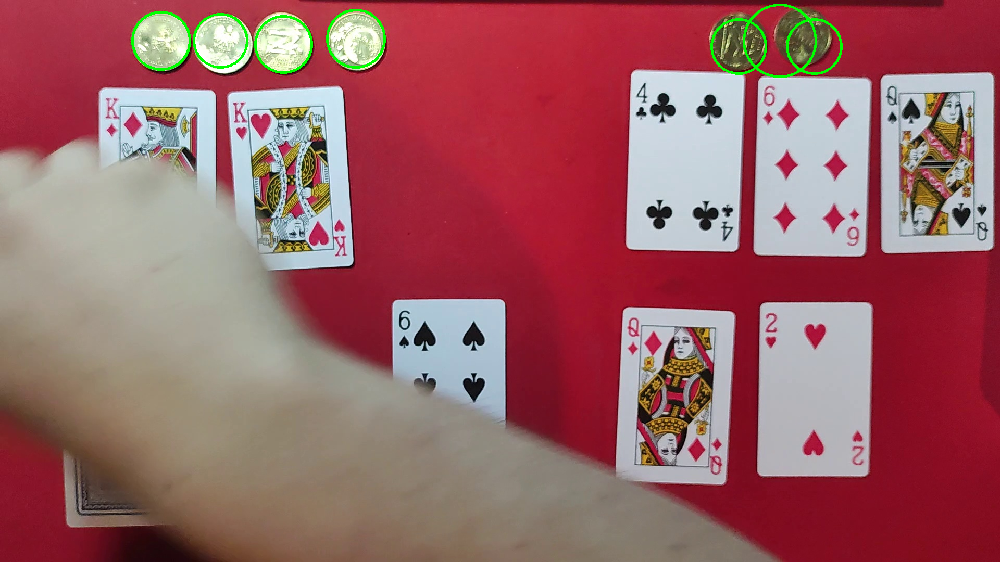

1.1 70


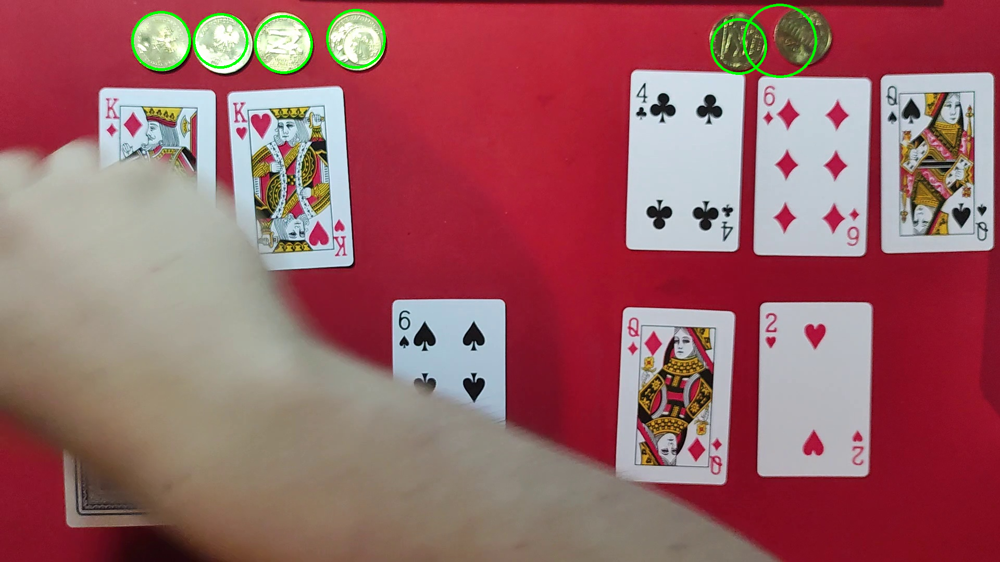

1.1 80


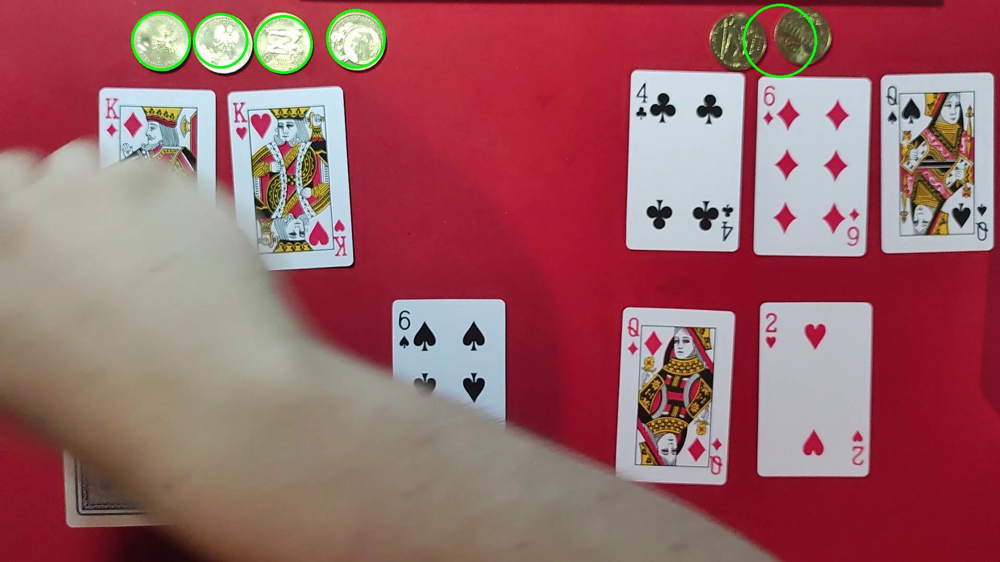

1.1 90


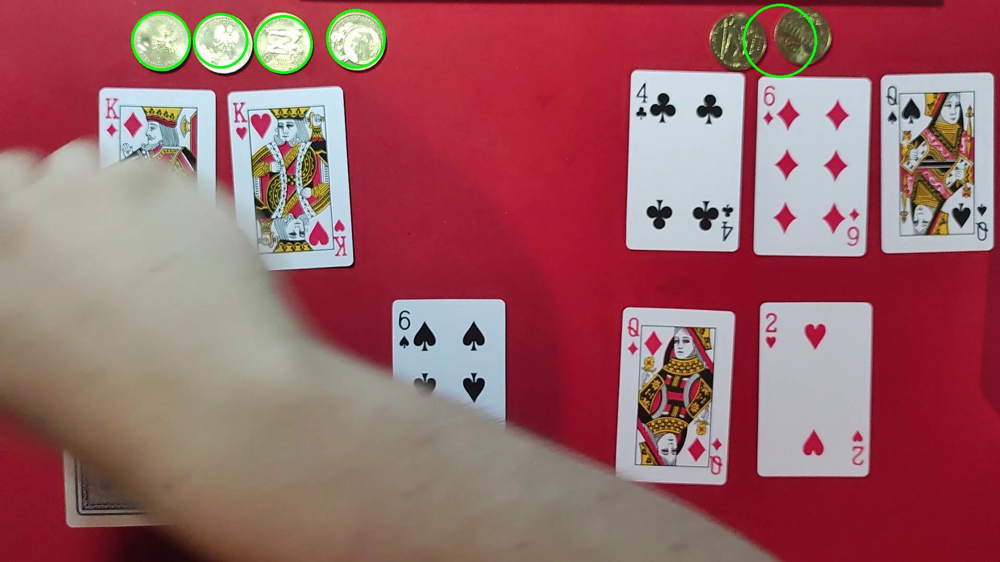

1.2 60


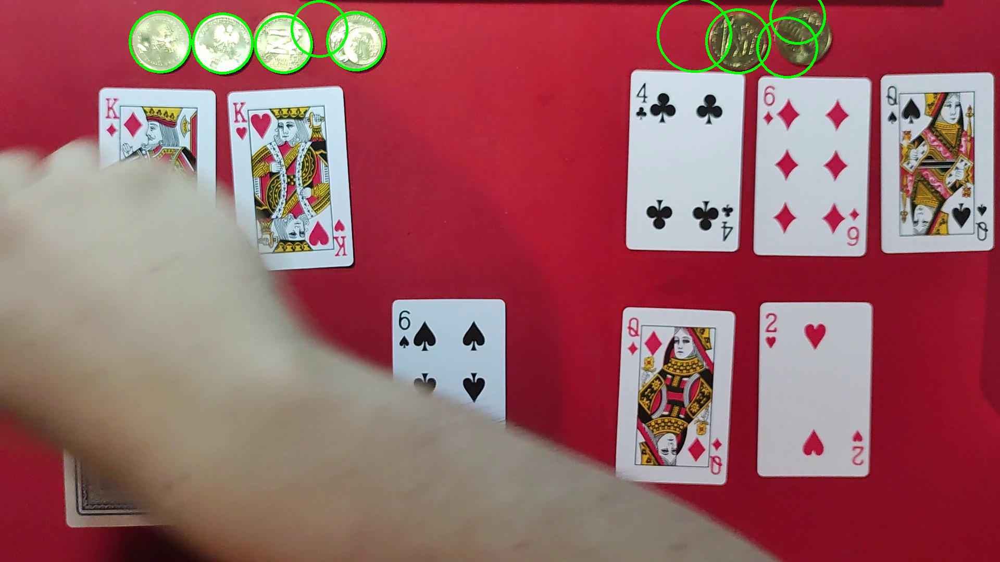

1.2 70


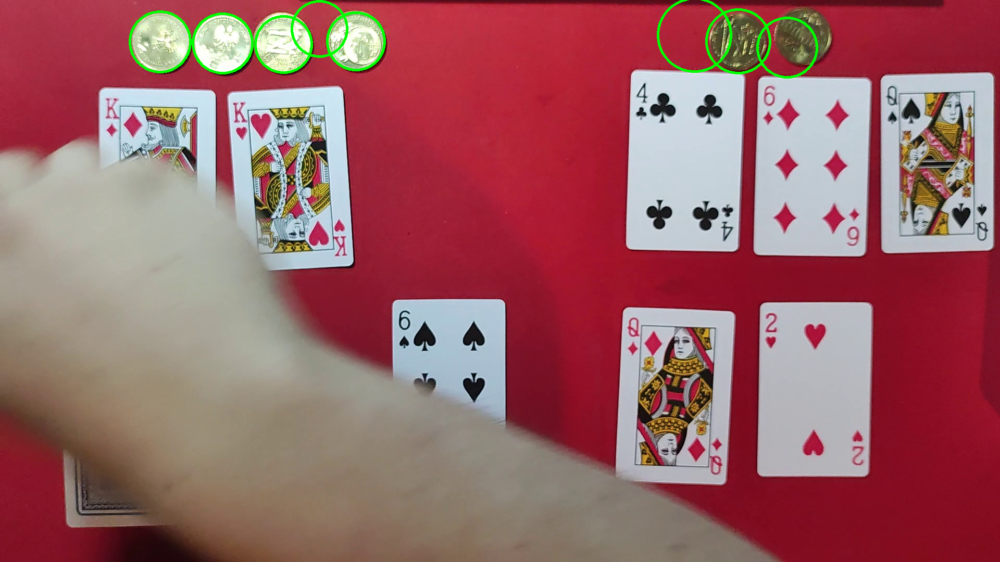

1.2 80


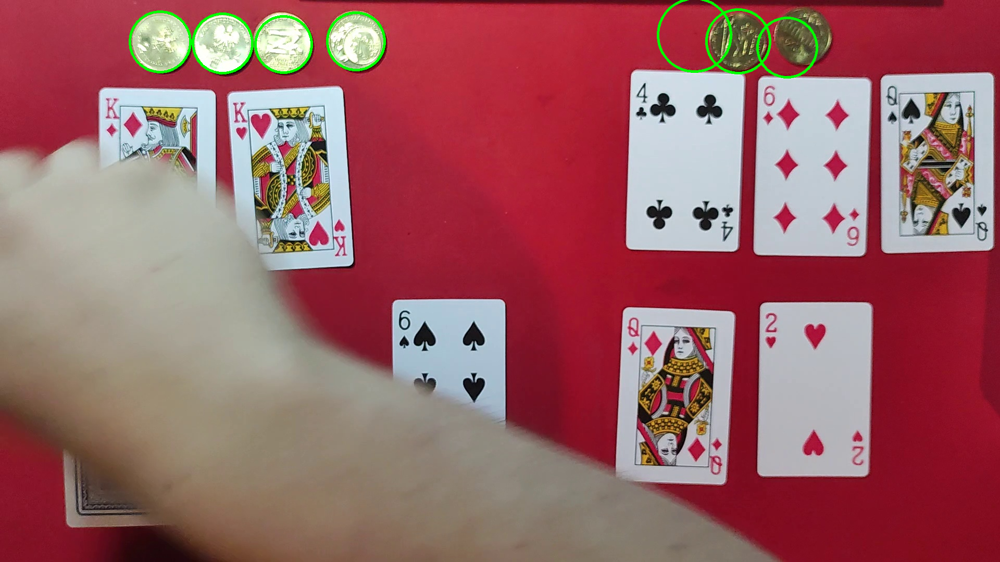

1.2 90


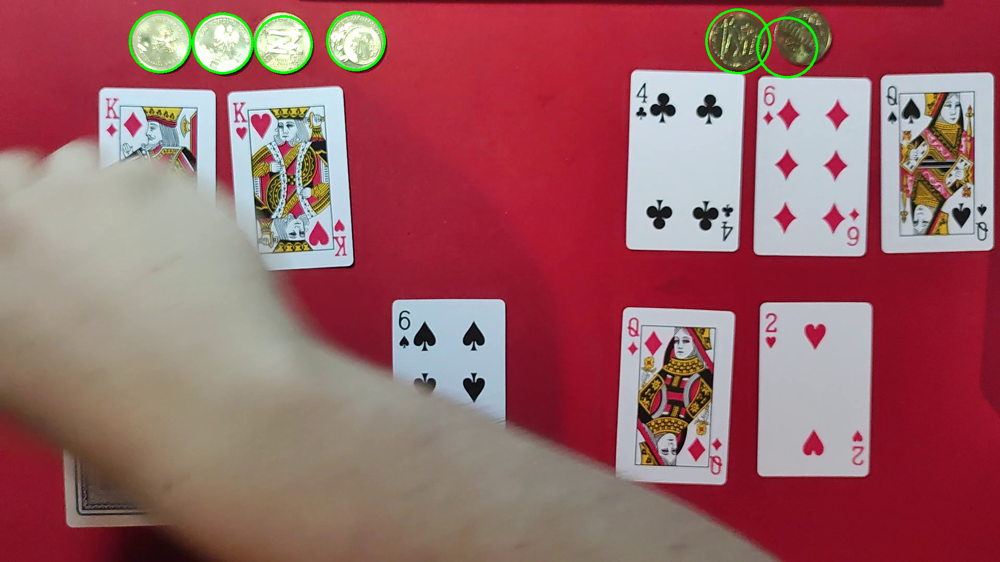

In [30]:
for i in [1.1, 1.2]:
    for j in [60, 70, 80, 90]:
        print(i, j)
        image = cv2.imread('test_Imgs/debug.jpg')
        output = image.copy()
        image = preprocess_image(image)
        circles = cv2.HoughCircles(image, cv2.HOUGH_GRADIENT, i, j, param1=32,  param2=32, minRadius=50, maxRadius=100)
        # ensure at least some circles were found
        if circles is not None:
            # convert the (x, y) coordinates and radius of the circles to integers
            circles = np.round(circles[0, :]).astype("int")
            # loop over the (x, y) coordinates and radius of the circles
            for (x, y, r) in circles:
                if y < 150:
                    cv2.circle(output, (x, y), r, (0, 255, 0), 4 )
        imshow(output)

In [211]:
for card in b:
    print(card.best_suit_match)

Unknown
Diamonds
Clubs
Clubs
Unknown
Unknown
Hearts
Unknown
Hearts


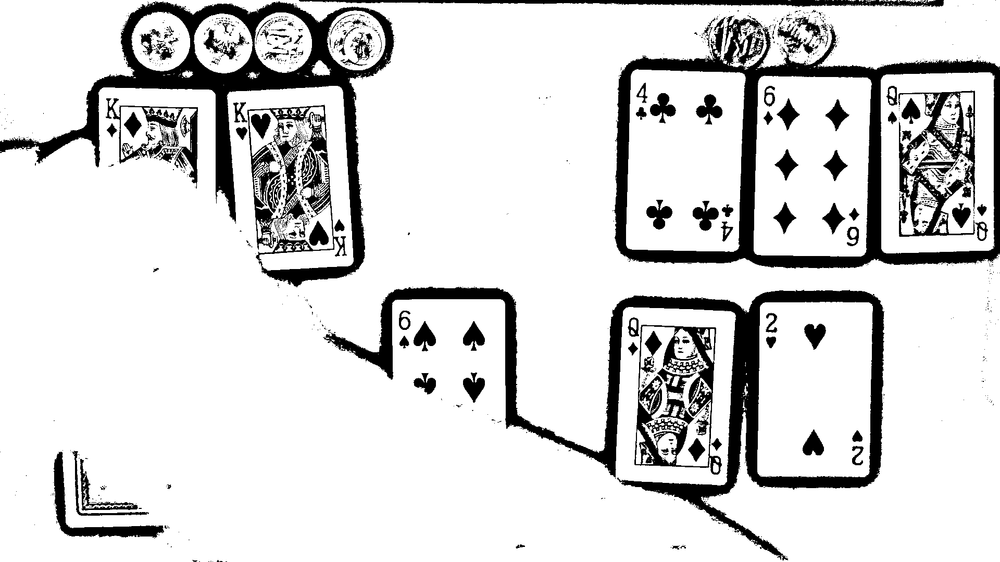

In [32]:
imshow(preprocess_image(cv2.imread('test_Imgs/debug.jpg')))
